# Import library

In [5]:
import numpy as np
import pandas as pd
import os
import pickle
# pip install holidays

import torch
from torch import nn
from torch.utils.data import DataLoader, Dataset, random_split, TensorDataset
import torch.nn.functional as F
import torch.nn.init as init

import scipy
import pickle
import random
import sys
from os.path import dirname, join as pjoin
import scipy.io as sio

sys.path.append(os.path.abspath(os.path.join(os.path.dirname('exp_ems'), '..')))
from utils.networks import *
from utils.trainer import *
from utils.formulations import *

datafolderpath = '../data'
saveresultfolderpath = '../result'

def check_missing_datetimes(df_check):
    # Ensure the index is datetime type
    df_check = df_check.dropna()
    resolution = pd.infer_freq(df_check.index)
    df_check.index = pd.to_datetime(df_check.index)

    # Check if there are any missing datetime values
    # Create a full range of datetimes covering the same period as merged_df's index
    full_date_range = pd.date_range(start=df_check.index.min(), end=df_check.index.max(), freq=resolution)

    # Check if the merged_df index matches the full range
    missing_datetimes = full_date_range.difference(df_check.index)

    if missing_datetimes.empty:
        print("No missing datetimes.")
    else:
        print(f"Missing datetimes: {missing_datetimes}")

# Import data
Dataframe must be arranged as 

[lagged regressors, future regressors, target variables]

In [6]:
dict_path = os.path.join(datafolderpath, 'data_netload_nonan.pkl')
with open(dict_path, 'rb') as pickle_file:
    data = pickle.load(pickle_file)
print(data.keys())

X_train = data['X_train']
y_train = data['y_train']
X_val = data['X_val']
y_val = data['y_val']
X_test = data['X_test']
y_test = data['y_test']

X_all = data['X_all']
y_all = data['y_all']
df_all = data['df_all_date']

target_col = data['target_col']
features_list = data['features_list']
future_regressor = data['future_regressor']

check_missing_datetimes(df_all)

dict_keys(['X_train', 'y_train', 'X_val', 'y_val', 'X_test', 'y_test', 'X_all', 'y_all', 'target_col', 'features_list', 'future_regressor', 'df_all_nonan', 'df_train_nonan', 'df_val_nonan', 'df_test_nonan', 'df_all_date', 'df_train_date', 'df_val_date', 'df_test_date', 'num_step_ahead', 'resolution'])
No missing datetimes.


In [7]:
import plotly.graph_objects as go

fig = go.Figure()
df_plot = df_all
# df_plot = df_split

fig.add_trace(go.Scatter(
    x=df_plot.index,
    y=df_plot['netload_kW'],
    mode='lines',
    name='Net Load rolling'
))

fig.update_layout(
    title='Net Load Over Time',
    xaxis_title='Datetime',
    yaxis_title='Power (kW)',
    xaxis=dict(tickformat='%Y-%m-%d %H:%M'),
    template='plotly_white'
)

fig.show()

# Sum-k

----------Training using: cpu----------
Epoch [10/2000], Training Loss: 0.6380, Val Loss: 0.6670
Epoch [20/2000], Training Loss: 0.1977, Val Loss: 0.2270
Epoch [30/2000], Training Loss: 0.1224, Val Loss: 0.1360
Epoch [40/2000], Training Loss: 0.1083, Val Loss: 0.1241
Epoch [50/2000], Training Loss: 0.1028, Val Loss: 0.1188
Epoch [60/2000], Training Loss: 0.0978, Val Loss: 0.1124
Epoch [70/2000], Training Loss: 0.0954, Val Loss: 0.1083
Epoch [80/2000], Training Loss: 0.0959, Val Loss: 0.1112
Epoch [90/2000], Training Loss: 0.0938, Val Loss: 0.1049
Epoch [100/2000], Training Loss: 0.0951, Val Loss: 0.1070
Epoch [110/2000], Training Loss: 0.0939, Val Loss: 0.1073
Epoch [120/2000], Training Loss: 0.0929, Val Loss: 0.1082
Epoch [130/2000], Training Loss: 0.0928, Val Loss: 0.1042
Epoch [140/2000], Training Loss: 0.0931, Val Loss: 0.1042
Epoch [150/2000], Training Loss: 0.0933, Val Loss: 0.1011
Epoch [160/2000], Training Loss: 0.0936, Val Loss: 0.1031
Epoch [170/2000], Training Loss: 0.0930, 

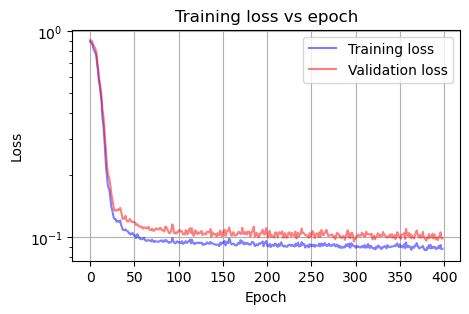

PICP of entire dataset
tensor([0.9135, 0.9245, 0.9015, 0.9053, 0.9091, 0.9032, 0.8854, 0.8890, 0.8882,
        0.9028, 0.8946, 0.9025, 0.8971, 0.9054, 0.8996, 0.9095])
PINALW of entire dataset
[0.413287   0.5916746  0.5039999  0.525334   0.58054227 0.60220635
 0.57925874 0.6267503  0.654277   0.7244827  0.70637083 0.72478867
 0.75160015 0.7551391  0.76105607 0.784876  ]
PICP of validation set: 15, 30, 45, 60 min ahead
tensor([0.9337, 0.9265, 0.8978, 0.9051, 0.9003, 0.8941, 0.8768, 0.8716, 0.8622,
        0.8791, 0.8697, 0.8913, 0.8669, 0.8911, 0.8866, 0.8962])
PICP of test set: 15, 30, 45, 60 min ahead
tensor([0.9538, 0.9455, 0.9182, 0.9218, 0.9179, 0.9112, 0.8969, 0.8947, 0.8893,
        0.9003, 0.8919, 0.9020, 0.8860, 0.9069, 0.8857, 0.9115])


In [139]:
# training Loss: 0.1326, the val. Loss: 0.1364.
# gamma_list = [0.15]
# gamma_list = [0.15]
gamma_list = [0.1]
delta = 0.1

for i, gamma in enumerate(gamma_list):
    torch.manual_seed(21)
    model = SolarkstepaheadNet_exoinput(lag_input_window_size = len(features_list) - len(target_col) - len(future_regressor)
                           , exo_input_window_size = len(future_regressor)
                           , hidden_size_common = 80, hidden_size_eachstep = 30, predicted_step = len(target_col))
    
    optimizer = torch.optim.Adam(model.parameters(), lr = 0.001)
    criterion = sumk_objective(delta_ = delta, gamma_ = gamma, percentlargest_ = 0.3, lambda_ = 0.9
                                              , soften_ = 50, smoothfunction = 'tanh')

    train = trainer_multistep(num_epochs = 2000, batch_size = int(0.3*X_train.shape[0]), patience = 100)
    train_loss_list, val_loss_list, model = train.training(X_train, y_train, X_val, y_val, criterion, optimizer, model)
    train.plotloss(train_loss_list, val_loss_list, returnplot = False, plotname= None)

    outputs_train_sumk = train.predict(X_train, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    outputs_val_sumk = train.predict(X_val, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    outputs_test_sumk = train.predict(X_test, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
        
    outputs_val_eval = outputs_val_sumk
    outputs_test_eval = outputs_test_sumk
        
    PICP_val = train.PICP(y_val, outputs_val_eval[:,1::2], outputs_val_eval[:,0::2])
    PICP_test = train.PICP(y_test, outputs_test_eval[:,1::2], outputs_test_eval[:,0::2])

    PINAW_test = train.PINAW(outputs_test_eval[:,1::2], outputs_test_eval[:,0::2], y_train)
    PINALW_test = train.PINALW(outputs_test_eval[:,1::2], outputs_test_eval[:,0::2], y_train)
    
    outputs_all_sumk = train.predict(X_all, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    PICP_all = train.PICP(y_all, outputs_all_sumk[:,1::2], outputs_all_sumk[:,0::2])
    PINALW_all = train.PINALW(outputs_all_sumk[:,1::2], outputs_all_sumk[:,0::2], y_train)
    print('PICP of entire dataset')
    print(PICP_all)
    print('PINALW of entire dataset')
    print(PINALW_all)
    
    print('PICP of validation set: 15, 30, 45, 60 min ahead')
    print(PICP_val)
    print('PICP of test set: 15, 30, 45, 60 min ahead')
    print(PICP_test)
#     print('PINAW of test set')
#     print(PINAW_test)
#     print('PINALW of test set: 15, 30, 45, 60 min ahead')
#     print(PINALW_test)

In [142]:
a = train.PINALW(outputs_test_sumk[:,1::2], outputs_test_sumk[:,0::2], y_train, quantile = 0.9)
b = train.PINALW(outputs_test_cwc[:,1::2], outputs_test_cwc[:,0::2], y_train, quantile = 0.9)
for i, (ai, bi) in enumerate(zip(a,b)):
    print(f'Step{i+1}, Sumk: {ai:.2f}, CWC: {bi:.2f}')

Step1, Sumk: 0.49, CWC: 0.54
Step2, Sumk: 0.74, CWC: 0.70
Step3, Sumk: 0.65, CWC: 0.72
Step4, Sumk: 0.68, CWC: 0.73
Step5, Sumk: 0.73, CWC: 0.79
Step6, Sumk: 0.75, CWC: 0.79
Step7, Sumk: 0.73, CWC: 0.91
Step8, Sumk: 0.74, CWC: 0.95
Step9, Sumk: 0.79, CWC: 0.98
Step10, Sumk: 0.90, CWC: 1.09
Step11, Sumk: 0.85, CWC: 1.04
Step12, Sumk: 1.01, CWC: 1.16
Step13, Sumk: 0.97, CWC: 1.11
Step14, Sumk: 1.06, CWC: 1.09
Step15, Sumk: 1.03, CWC: 1.28
Step16, Sumk: 1.13, CWC: 1.17


# CWCshri

----------Training using: cpu----------
Epoch [10/2000], Training Loss: 2.0213, Val Loss: 2.1154
Epoch [20/2000], Training Loss: 1.8354, Val Loss: 1.9210
Epoch [30/2000], Training Loss: 1.6251, Val Loss: 1.7406
Epoch [40/2000], Training Loss: 1.5767, Val Loss: 1.6458
Epoch [50/2000], Training Loss: 1.5504, Val Loss: 1.6508
Epoch [60/2000], Training Loss: 1.4379, Val Loss: 1.4664
Epoch [70/2000], Training Loss: 1.4173, Val Loss: 1.4748
Epoch [80/2000], Training Loss: 1.4162, Val Loss: 1.4526
Epoch [90/2000], Training Loss: 1.4131, Val Loss: 1.4421
Epoch [100/2000], Training Loss: 1.4085, Val Loss: 1.4390
Epoch [110/2000], Training Loss: 1.4124, Val Loss: 1.4238
Epoch [120/2000], Training Loss: 1.4028, Val Loss: 1.4246
Epoch [130/2000], Training Loss: 1.4698, Val Loss: 1.5273
Epoch [140/2000], Training Loss: 1.3971, Val Loss: 1.4233
Epoch [150/2000], Training Loss: 1.3865, Val Loss: 1.4204
Epoch [160/2000], Training Loss: 1.4303, Val Loss: 1.4789
Epoch [170/2000], Training Loss: 1.4016, 

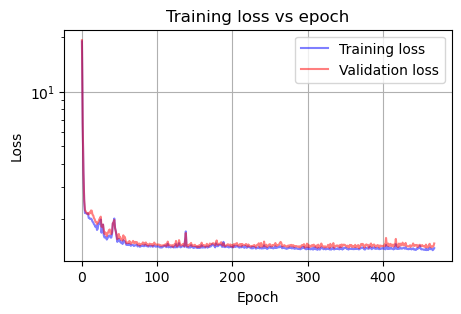

PICP of entire dataset
tensor([0.9164, 0.9166, 0.9107, 0.9010, 0.9085, 0.9035, 0.9104, 0.9015, 0.8953,
        0.8979, 0.8974, 0.9115, 0.8927, 0.9001, 0.9218, 0.9094])
PINALW of entire dataset
[0.38781172 0.47769707 0.49628833 0.5094908  0.54179674 0.5793964
 0.6658061  0.6249484  0.61165345 0.7014191  0.65093565 0.7579243
 0.7254131  0.7062823  0.8706193  0.7656535 ]
PICP of validation set: 15, 30, 45, 60 min ahead
tensor([0.9502, 0.9232, 0.9042, 0.8895, 0.9016, 0.8949, 0.8892, 0.8753, 0.8767,
        0.8651, 0.8799, 0.8892, 0.8814, 0.8727, 0.9095, 0.8981])
PICP of test set: 15, 30, 45, 60 min ahead
tensor([0.9593, 0.9401, 0.9315, 0.9065, 0.9228, 0.9151, 0.9114, 0.9173, 0.8974,
        0.9148, 0.9065, 0.9184, 0.9084, 0.9078, 0.9286, 0.9151])


In [125]:
# training Loss: 0.1326, the val. Loss: 0.1364.
# gamma_list = [5]
gamma_list = [4]
delta = 0.1

for i, gamma in enumerate(gamma_list):
    torch.manual_seed(21)
    model = SolarkstepaheadNet_exoinput(lag_input_window_size = len(features_list) - len(target_col) - len(future_regressor)
                           , exo_input_window_size = len(future_regressor)
                           , hidden_size_common = 80, hidden_size_eachstep = 30, predicted_step = len(target_col))
    
    optimizer = torch.optim.Adam(model.parameters(), lr = 0.01)
    criterion = cwcshri_objective(delta_ = delta, gamma_ = gamma, soften_ = 50, smoothfunction = 'tanh')

    train = trainer_multistep(num_epochs = 2000, batch_size = int(0.3*X_train.shape[0]), patience = 100)
    train_loss_list, val_loss_list, model = train.training(X_train, y_train, X_val, y_val, criterion, optimizer, model)
    train.plotloss(train_loss_list, val_loss_list, returnplot = False, plotname= None)

    outputs_train_cwc = train.predict(X_train, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    outputs_val_cwc = train.predict(X_val, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    outputs_test_cwc = train.predict(X_test, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
        
    outputs_val_eval = outputs_val_cwc
    outputs_test_eval = outputs_test_cwc
        
    PICP_val = train.PICP(y_val, outputs_val_eval[:,1::2], outputs_val_eval[:,0::2])
    PICP_test = train.PICP(y_test, outputs_test_eval[:,1::2], outputs_test_eval[:,0::2])

    PINAW_test = train.PINAW(outputs_test_eval[:,1::2], outputs_test_eval[:,0::2], y_train)
    PINALW_test = train.PINALW(outputs_test_eval[:,1::2], outputs_test_eval[:,0::2], y_train)
    
    outputs_all_cwc = train.predict(X_all, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    PICP_all = train.PICP(y_all, outputs_all_cwc[:,1::2], outputs_all_cwc[:,0::2])
    PINALW_all = train.PINALW(outputs_all_cwc[:,1::2], outputs_all_cwc[:,0::2], y_train)
    print('PICP of entire dataset')
    print(PICP_all)
    print('PINALW of entire dataset')
    print(PINALW_all)
    
    print('PICP of validation set: 15, 30, 45, 60 min ahead')
    print(PICP_val)
    print('PICP of test set: 15, 30, 45, 60 min ahead')
    print(PICP_test)
#     print('PINAW of test set')
#     print(PINAW_test)
#     print('PINALW of test set: 15, 30, 45, 60 min ahead')
#     print(PINALW_test)

# QD

----------Training using: cpu----------
Epoch [10/2000], Training Loss: 0.0103, Val Loss: 0.0101
Epoch [20/2000], Training Loss: 0.0089, Val Loss: 0.0103
Epoch [30/2000], Training Loss: 0.0075, Val Loss: 0.0131
Epoch [40/2000], Training Loss: 0.0062, Val Loss: 0.0113
Epoch [50/2000], Training Loss: 0.0054, Val Loss: 0.0098
Epoch [60/2000], Training Loss: 0.0050, Val Loss: 0.0106
Epoch [70/2000], Training Loss: 0.0071, Val Loss: 0.0150
Epoch [80/2000], Training Loss: 0.0045, Val Loss: 0.0120
Epoch [90/2000], Training Loss: 0.0046, Val Loss: 0.0106
Epoch [100/2000], Training Loss: 0.0055, Val Loss: 0.0079
Epoch [110/2000], Training Loss: 0.0051, Val Loss: 0.0103
Epoch [120/2000], Training Loss: 0.0052, Val Loss: 0.0126
Epoch [130/2000], Training Loss: 0.0039, Val Loss: 0.0095
Epoch [140/2000], Training Loss: 0.0037, Val Loss: 0.0093
Epoch [150/2000], Training Loss: 0.0038, Val Loss: 0.0077
Epoch [160/2000], Training Loss: 0.0038, Val Loss: 0.0088
Epoch [170/2000], Training Loss: 0.0036, 

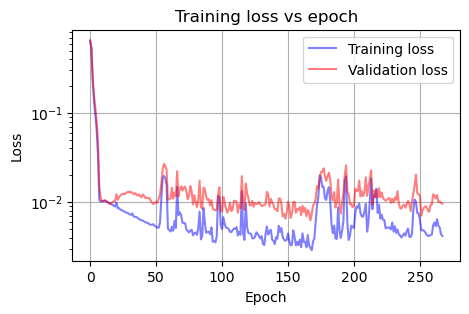

PICP of entire dataset
tensor([0.9085, 0.9158, 0.9040, 0.8858, 0.8940, 0.8862, 0.8836, 0.8717, 0.8826,
        0.8867, 0.9106, 0.8917, 0.8927, 0.8715, 0.8144, 0.8806])
PINALW of entire dataset
[0.22676685 0.21394065 0.2781511  0.3508663  0.36274722 0.4242306
 0.48995632 0.5016137  0.54555655 0.59673566 0.6569688  0.6287253
 0.72434914 0.5729687  0.5739724  0.6564659 ]


In [606]:
# training Loss: 0.1326, the val. Loss: 0.1364.
gamma_list = [0.01]
delta = 0.1

for i, gamma in enumerate(gamma_list):
    torch.manual_seed(21)
    model = SolarkstepaheadNet_exoinput(lag_input_window_size = len(features_list) - len(target_col) - len(future_regressor)
                           , exo_input_window_size = len(future_regressor)
                           , hidden_size_common = 80, hidden_size_eachstep = 30, predicted_step = len(target_col))
    
    optimizer = torch.optim.Adam(model.parameters(), lr = 0.005)
    criterion = qd_objective(delta_ = delta, gamma_ = gamma, soften_ = 50, smoothfunction = 'tanh')

    train = trainer_multistep(num_epochs = 2000, batch_size = int(0.3*X_train.shape[0]), patience = 100)
    train_loss_list, val_loss_list, model = train.training(X_train, y_train, X_val, y_val, criterion, optimizer, model)
    train.plotloss(train_loss_list, val_loss_list, returnplot = False, plotname= None)

    outputs_train_qd = train.predict(X_train, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    outputs_val_qd = train.predict(X_val, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    outputs_test_qd = train.predict(X_test, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
        
    outputs_val_eval = outputs_val_qd
    outputs_test_eval = outputs_test_qd
        
    PICP_val = train.PICP(y_val, outputs_val_eval[:,1::2], outputs_val_eval[:,0::2])
    PICP_test = train.PICP(y_test, outputs_test_eval[:,1::2], outputs_test_eval[:,0::2])

    PINAW_test = train.PINAW(outputs_test_eval[:,1::2], outputs_test_eval[:,0::2], y_train)
    PINALW_test = train.PINALW(outputs_test_eval[:,1::2], outputs_test_eval[:,0::2], y_train)
    
    outputs_all_qd = train.predict(X_all, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    PICP_all = train.PICP(y_all, outputs_all_qd[:,1::2], outputs_all_qd[:,0::2])
    PINALW_all = train.PINALW(outputs_all_qd[:,1::2], outputs_all_qd[:,0::2], y_train)
    print('PICP of entire dataset')
    print(PICP_all)
    print('PINALW of entire dataset')
    print(PINALW_all)
    
#     print('PICP of validation set: 15, 30, 45, 60 min ahead')
#     print(PICP_val)
#     print('PICP of test set: 15, 30, 45, 60 min ahead')
#     print(PICP_test)
#     print('PINAW of test set')
#     print(PINAW_test)
#     print('PINALW of test set: 15, 30, 45, 60 min ahead')
#     print(PINALW_test)

# Quantile regression

----------Training using: cpu----------
Epoch [10/2000], Training Loss: 0.9047, Val Loss: 1.3193
Epoch [20/2000], Training Loss: 0.3942, Val Loss: 0.5154
Epoch [30/2000], Training Loss: 0.3207, Val Loss: 0.3990
Epoch [40/2000], Training Loss: 0.2927, Val Loss: 0.3630
Epoch [50/2000], Training Loss: 0.2741, Val Loss: 0.3444
Epoch [60/2000], Training Loss: 0.2607, Val Loss: 0.3268
Epoch [70/2000], Training Loss: 0.2500, Val Loss: 0.3246
Epoch [80/2000], Training Loss: 0.2428, Val Loss: 0.3194
Epoch [90/2000], Training Loss: 0.2386, Val Loss: 0.3190
Epoch [100/2000], Training Loss: 0.2550, Val Loss: 0.3560
Epoch [110/2000], Training Loss: 0.2356, Val Loss: 0.3283
Epoch [120/2000], Training Loss: 0.2291, Val Loss: 0.3300
Epoch [130/2000], Training Loss: 0.2288, Val Loss: 0.3394
Epoch [140/2000], Training Loss: 0.2246, Val Loss: 0.3322
Epoch [150/2000], Training Loss: 0.2259, Val Loss: 0.3502
Epoch [160/2000], Training Loss: 0.2130, Val Loss: 0.3431
Early stopping occurs within 166 Epochs.


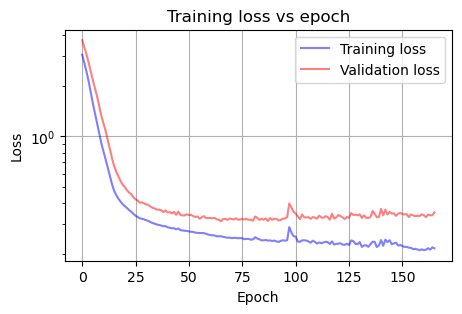

PICP of entire dataset
tensor([0.9631, 0.9232, 0.8641, 0.8275, 0.9051, 0.9204, 0.8869, 0.9065, 0.8600,
        0.9030, 0.8626, 0.8439, 0.9086, 0.9099, 0.9234, 0.9080])
PINALW of entire dataset
[0.17261374 0.25061494 0.3224647  0.45185864 0.5115717  0.6332395
 0.6321222  0.64121944 0.70191765 0.77451193 0.79753155 0.7318498
 0.7850963  0.81892824 0.91426325 0.824008  ]


In [605]:
# training Loss: 0.1326, the val. Loss: 0.1364.
delta_list = [0.1]

for i, delta in enumerate(delta_list):
    torch.manual_seed(21)
    model = SolarkstepaheadNet_exoinput(lag_input_window_size = len(features_list) - len(target_col) - len(future_regressor)
                           , exo_input_window_size = len(future_regressor)
                           , hidden_size_common = 80, hidden_size_eachstep = 30, predicted_step = len(target_col))
    
    optimizer = torch.optim.Adam(model.parameters(), lr = 0.001)
    criterion = qr_objective(delta_ = delta)

    train = trainer_multistep(num_epochs = 2000, batch_size = int(0.3*X_train.shape[0]), patience = 100)
    train_loss_list, val_loss_list, model = train.training(X_train, y_train, X_val, y_val, criterion, optimizer, model)
    train.plotloss(train_loss_list, val_loss_list, returnplot = False, plotname= None)

    outputs_train_qr = train.predict(X_train, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    outputs_val_qr = train.predict(X_val, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    outputs_test_qr = train.predict(X_test, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
        
    outputs_val_eval = outputs_val_qr
    outputs_test_eval = outputs_test_qr
        
    PICP_val = train.PICP(y_val, outputs_val_eval[:,1::2], outputs_val_eval[:,0::2])
    PICP_test = train.PICP(y_test, outputs_test_eval[:,1::2], outputs_test_eval[:,0::2])

    PINAW_test = train.PINAW(outputs_test_eval[:,1::2], outputs_test_eval[:,0::2], y_train)
    PINALW_test = train.PINALW(outputs_test_eval[:,1::2], outputs_test_eval[:,0::2], y_train)
    
    outputs_all_qr = train.predict(X_all, model, ymean = torch.mean(y_train), ystd = torch.std(y_train))
    PICP_all = train.PICP(y_all, outputs_all_qr[:,1::2], outputs_all_qr[:,0::2])
    PINALW_all = train.PINALW(outputs_all_qr[:,1::2], outputs_all_qr[:,0::2], y_train)
    print('PICP of entire dataset')
    print(PICP_all)
    print('PINALW of entire dataset')
    print(PINALW_all)
    
#     print('PICP of validation set: 15, 30, 45, 60 min ahead')
#     print(PICP_val)
#     print('PICP of test set: 15, 30, 45, 60 min ahead')
#     print(PICP_test)
#     print('PINAW of test set')
#     print(PINAW_test)
#     print('PINALW of test set: 15, 30, 45, 60 min ahead')
#     print(PINALW_test)

# Import LSTM result

In [8]:
dict_path = './result/sumk_gam02_netload_16step_k03_lam05.pkl' # Finalized 9 windows

with open(dict_path, 'rb') as pickle_file:
    result_sumk = pickle.load(pickle_file)
print(result_sumk.keys())
outputs_train_sumk = result_sumk['outputs_train']
outputs_val_sumk = result_sumk['outputs_val']
outputs_all_sumk = result_sumk['outputs_all']
gamma_sumk = result_sumk['gamma']
print(f'Sumk gamma = {gamma_sumk}')

dict_path = './result/qd_gam0011_netload_16step.pkl' # Finalized 9 windows
with open(dict_path, 'rb') as pickle_file:
    result_qd = pickle.load(pickle_file)
print(result_qd.keys())
outputs_train_qd = result_qd['outputs_train']
outputs_val_qd = result_qd['outputs_val']
outputs_all_qd = result_qd['outputs_all']
gamma_qd = result_qd['gamma']
print(f'QD gamma = {gamma_qd}')

dict_path = './result/cwcshri_gam4_netload_16step.pkl' # Finalized 9 windows
with open(dict_path, 'rb') as pickle_file:
    result_cwcshri = pickle.load(pickle_file)
print(result_cwcshri.keys())
outputs_train_cwc = result_cwcshri['outputs_train']
outputs_val_cwc = result_cwcshri['outputs_val']
outputs_all_cwc = result_cwcshri['outputs_all']
gamma_cwc = result_cwcshri['gamma']
print(f'CWC gamma = {gamma_cwc}')

dict_path = './result/qr_netload_16step_seed350.pkl' # Finalized 9 windows
with open(dict_path, 'rb') as pickle_file:
    result_qr = pickle.load(pickle_file)
print(result_qr.keys())
outputs_train_qr = result_qr['outputs_train']
outputs_val_qr = result_qr['outputs_val']
outputs_all_qr = result_qr['outputs_all']

## Define model and trainer
train = trainer_multistep(num_epochs = 2000, batch_size = 2000, patience = 200) #Set the trainer

pi_eval_list = [outputs_val_sumk, outputs_val_cwc, outputs_val_qd, outputs_val_qr]
method_name = ['Sum-k', 'CWC', 'QD', 'QR']
print('----- PICP in validation set -----')
for pi_eval, method in zip(pi_eval_list, method_name):
    print(f'{method}')
    PICP_val = train.PICP(y_val, pi_eval[:,1::2], pi_eval[:,0::2])
    print(PICP_val)
print('----- PICP in entire data set -----')
pi_eval_list = [outputs_all_sumk, outputs_all_cwc, outputs_all_qd, outputs_all_qr]
for pi_eval, method in zip(pi_eval_list, method_name):
    print(f'{method}')
    PICP_all = train.PICP(y_all, pi_eval[:,1::2], pi_eval[:,0::2])
    print(PICP_all)
print('----- PINALW in entire data set -----')
pi_eval_list = [outputs_all_sumk, outputs_all_cwc, outputs_all_qd, outputs_all_qr]
for pi_eval, method in zip( pi_eval_list, method_name):
    print(f'{method}')
    PINALW_all = train.PINALW(pi_eval[:,1::2], pi_eval[:,0::2], y_all)
    print(PINALW_all)

dict_keys(['outputs_train', 'outputs_val', 'outputs_all', 'outputs_test', 'gamma'])
Sumk gamma = [0.2]
dict_keys(['outputs_train', 'outputs_val', 'outputs_all', 'outputs_test', 'gamma'])
QD gamma = [0.011]
dict_keys(['outputs_train', 'outputs_val', 'outputs_all', 'outputs_test', 'gamma'])
CWC gamma = [4]
dict_keys(['outputs_train', 'outputs_val', 'outputs_all', 'outputs_test'])
----- PICP in validation set -----
Sum-k
tensor([0.8990, 0.9029, 0.8954, 0.8882, 0.8746, 0.8525, 0.8404, 0.8441, 0.8452,
        0.8161, 0.8199, 0.8214, 0.8127, 0.8150, 0.8213, 0.8228])
CWC
tensor([0.8655, 0.8893, 0.8583, 0.8999, 0.8891, 0.8746, 0.8867, 0.8509, 0.8932,
        0.8729, 0.8348, 0.8749, 0.8617, 0.8494, 0.8466, 0.8533])
QD
tensor([0.8750, 0.8951, 0.8697, 0.8529, 0.8724, 0.8519, 0.8547, 0.8432, 0.8661,
        0.8214, 0.8477, 0.8221, 0.8323, 0.8167, 0.8353, 0.8573])
QR
tensor([0.9435, 0.9384, 0.8723, 0.8919, 0.8796, 0.9004, 0.8350, 0.8113, 0.8591,
        0.9062, 0.8518, 0.8762, 0.8940, 0.8906, 0.828

# Plot result

In [9]:
import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default = 'notebook_connected'  # or 'notebook'

fig = go.Figure()
step_ahead = 1
y_plot = y_all[:, step_ahead - 1]

# Extract intervals for each method
pi_plot_sumk = outputs_all_sumk[:, 2 * (step_ahead - 1): 2 * (step_ahead)]
pi_plot_qd = outputs_all_qd[:, 2 * (step_ahead - 1): 2 * (step_ahead)]
pi_plot_cwc = outputs_all_cwc[:, 2 * (step_ahead - 1): 2 * (step_ahead)]
pi_plot_qr = outputs_all_qr[:, 2 * (step_ahead - 1): 2 * (step_ahead)]

x = np.arange(len(y_plot))

# Ground truth
fig.add_trace(go.Scatter(
    x=x,
    y=y_plot,
    mode='lines',
    name='Ground Truth',
    
    line=dict(color='black')
))

# Function to add PI bands
def add_pi_band(fig, x, pi, name, fillcolor):
    fig.add_trace(go.Scatter(
        x=x,
        y=pi[:, 1],
        mode='lines',
        line=dict(width=0),
        showlegend=False
    ))
    fig.add_trace(go.Scatter(
        x=x,
        y=pi[:, 0],
        mode='lines',
        fill='tonexty',
        fillcolor=fillcolor,
        line=dict(width=0),
        name=name
    ))

# Add PIs with distinguishable colors
add_pi_band(fig, x, pi_plot_sumk, 'Sumk PI', 'rgba(0, 0, 255, 0.3)')   # blue
add_pi_band(fig, x, pi_plot_qd, 'QD PI', 'rgba(255, 0, 0, 0.3)')       # red
add_pi_band(fig, x, pi_plot_cwc, 'CWC PI', 'rgba(0, 128, 0, 0.3)')     # green
add_pi_band(fig, x, pi_plot_qr, 'QR PI', 'rgba(255, 165, 0, 0.3)')     # orange

fig.update_layout(
    title=f'Prediction Intervals for Step Ahead {step_ahead}',
    xaxis_title='Time Index',
    yaxis_title='Value',
    template='plotly_white'
)

fig.show()

# Aggregate result as csv

In [729]:
df_netload = df_all
pi_list = [outputs_all_sumk, outputs_all_cwc, outputs_all_qd, outputs_all_qr]
method_name = ['sumk', 'cwc', 'qd', 'qr']

for method, pi_allstep in zip(method_name, pi_list):
    df_forecast = df_netload.copy()
    for step_ahead in range(1, int(pi_allstep.shape[1]/2) + 1):
        pi_each_step = pi_allstep[:, 2 * (step_ahead - 1): 2 * (step_ahead)]
        upper = pi_each_step[:, 1]
        lower = pi_each_step[:, 0]
        upper_colname = f'upper_{step_ahead}'
        df_forecast[upper_colname] = upper
        lower_colname = f'lower_{step_ahead}'
        df_forecast[lower_colname] = lower
    
    df_forecast = df_forecast.resample('15T').asfreq()
    # Remove the first date then the EMS starts at 00:00
    dates = df_forecast.index.normalize()
    first_date = dates.min()
    df_forecast = df_forecast[(dates != first_date)]
    
    # Drop lower bound column for using as input for EMS
    df_upper = df_forecast.drop(columns=[col for col in df_forecast.columns if 'lower' in col])
    df_lower = df_forecast.drop(columns=[col for col in df_forecast.columns if 'upper' in col])
    
    print('Upper bound')
    check_missing_datetimes(df_upper)
    print('Lower bound')
    check_missing_datetimes(df_lower)
    
#     df_upper.to_csv(f'../data/netload_upper_forecast_{method}.csv', index = True)
#     df_lower.to_csv(f'../data/netload_lower_forecast_{method}.csv', index = True)

Upper bound
No missing datetimes.
Lower bound
No missing datetimes.
Upper bound
No missing datetimes.
Lower bound
No missing datetimes.
Upper bound
No missing datetimes.
Lower bound
No missing datetimes.
Upper bound
No missing datetimes.
Lower bound
No missing datetimes.
